In [1]:
import dask_mongo
from dask_cuda import LocalCUDACluster
from dask.distributed import Client, futures_of, as_completed
from dask import array as da
import numpy as np
import pandas as pd
import logging
import os
import pathlib
import sys

In [23]:
from utils import rotate_image

In [2]:
sys.path.append(pathlib.Path(os.getcwd(), 'deepface').as_posix())

In [3]:
from deepface import DeepFace

2023-03-11 15:59:30.224721: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.
2023-03-11 15:59:30.761494: W tensorflow/compiler/xla/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libnvinfer.so.7'; dlerror: libnvinfer.so.7: cannot open shared object file: No such file or directory; LD_LIBRARY_PATH: /home/anuvini/mambaforge/envs/aialbum/lib/python3.10/site-packages/cv2/../../lib64::/usr/local/cuda/lib64/
2023-03-11 15:59:30.761547: W tensorflow/compiler/xla/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libnvinfer_plugin.so.7'; dlerror: libnvinfer_plugin.so.7: cannot open shared object file: No such file or directory; LD_LIBRARY_PATH: /home/anuvini/mambaforg

In [4]:
cluster = LocalCUDACluster(silence_logs=logging.ERROR)
client = Client(cluster,)

2023-03-11 15:59:32,027 - distributed.preloading - INFO - Creating preload: dask_cuda.initialize
2023-03-11 15:59:32,027 - distributed.preloading - INFO - Import preload module: dask_cuda.initialize
2023-03-11 15:59:32,033 - distributed.preloading - INFO - Creating preload: dask_cuda.initialize
2023-03-11 15:59:32,033 - distributed.preloading - INFO - Import preload module: dask_cuda.initialize


In [5]:
cluster

LocalCUDACluster(10283cda, 'tcp://127.0.0.1:41273', workers=2, threads=2, memory=125.74 GiB)

In [6]:
bag = dask_mongo.read_mongo(
    database="ai_album",
    collection="media",
    connection_kwargs={
        "host": "localhost", 
        "port": 27017,
        "username": "aialbumadmin",
        "password": "aialbumpw"
    },
    chunksize=10,
)

In [7]:
def dist_func(enc1, enc2):
    return DeepFace.dst.findCosineDistance(enc1, enc2)

In [8]:
DeepFace.dst.findThreshold('Facenet512', 'cosine')

0.3

In [9]:
def has_faces(x):
    if 'faceEncodings' in x and len(x['faceEncodings']) > 0:
        return True
    
    return False

def as_df(x):
    arr = []
    
    for fid, enc in enumerate(x['faceEncodings']):
        dct_meta = dict()
        dct_meta['_id'] = str(x['_id'])
        dct_meta['face'] = x['faces'][fid]
        dct_meta['enc'] = np.array(enc)
        dct_meta['path'] = x['path']
        arr.append(dct_meta)
    
    return arr
        
with_faces = bag.filter(has_faces)
formatted = with_faces.map(as_df)
flattened = formatted.flatten()
flattened = flattened.repartition(npartitions=20)
flattened = flattened.persist()

In [10]:
ff = futures_of(flattened)

In [11]:


def comp(item, x=[]):
    if 'similar' not in item:
        item['similar'] = []
        item['dist'] = []
        item['sim_face'] = []
        item['sim_path'] = []
        
    for item2 in x:
        if item['_id'] == item2['_id']:
            continue
        if item2['_id'] in item['similar']:
            continue
        dist = dist_func(item['enc'], item2['enc'])
        if dist < 0.3:
            item['similar'].append(item2['_id'])
            item['dist'].append(dist)
            item['sim_face'].append(item2['face'])
            item['sim_path'].append(item2['path'])

    return item


history = [flattened]
for n, item in enumerate(as_completed(ff)):
    partition_items = item.result()
    new = history[-1].map(comp, x=partition_items)
    history.append(new)

compared = history[-1]

In [12]:
from PIL import Image, ImageDraw
import matplotlib.pyplot as plt
from utils import resize
from pillow_heif import register_heif_opener

register_heif_opener()

In [13]:
# https://keestalkstech.com/2020/05/plotting-a-grid-of-pil-images-in-jupyter/

def display_images(
    images: [Image], 
    columns=5, width=20, height=8, max_images=15, 
    label_wrap_length=50, label_font_size=8):

    if not images:
        print("No images to display.")
        return 

    if len(images) > max_images:
        print(f"Showing {max_images} images of {len(images)}:")
        images=images[0:max_images]

    height = max(height, int(len(images)/columns) * height)
    plt.figure(figsize=(width, height))
    for i, image in enumerate(images):

        plt.subplot(int(len(images) / columns + 1), columns, i + 1)
        plt.imshow(image)

        if hasattr(image, 'filename'):
            title=image.filename
            if title.endswith("/"): title = title[0:-1]
            title=os.path.basename(title)
            title=textwrap.wrap(title, label_wrap_length)
            title="\n".join(title)
            plt.title(title, fontsize=label_font_size)

In [14]:
xx = compared.filter(lambda x: '20191220_202647.jpg' in x['path'])

In [15]:
d = xx.take(1, npartitions=20)[0]

In [16]:
d['path']

'Bali 21-31_12_2019/Nikon D5600/Note 10+/20191220_202647.jpg'

In [21]:
def show_image(path, face):
    img = Image.open(f'/media/anuvini/Anuradha WD/Family/{path}').convert('RGB')
    img = rotate_image(img)
    img_bb = ImageDraw.Draw(img)
    print(face)
    (top, right, bottom, left) = face['top'], face['right'], face['bottom'], face['left']
    shape = [left, top, right, bottom]
    img_bb.rectangle(shape, outline="red", width=20)
    ratio, img = resize(img, 500, 500)
    return img

In [24]:
images = [show_image(d['path'], d['face'])]

for x in range(100):
    images.append(show_image(d['sim_path'][x], d['sim_face'][x]))
    print(d['dist'][x])
    
    

{'top': 522, 'left': 117, 'bottom': 1204, 'right': 632}
{'top': 2187, 'left': 3099, 'bottom': 2410, 'right': 3284}
0.2507581999015184
{'top': 2158, 'left': 2842, 'bottom': 2377, 'right': 3030}
0.24429147200617018
{'top': 2258, 'left': 2779, 'bottom': 2485, 'right': 2977}
0.2266216144204104
{'top': 2119, 'left': 2770, 'bottom': 2348, 'right': 2962}
0.25335394405169487
{'top': 2121, 'left': 2724, 'bottom': 2346, 'right': 2920}
0.22830634869910127
{'top': 2111, 'left': 2706, 'bottom': 2345, 'right': 2900}
0.2492084222000005
{'top': 1869, 'left': 2945, 'bottom': 2164, 'right': 3178}
0.22820230189110446
{'top': 1936, 'left': 2861, 'bottom': 2233, 'right': 3101}
0.22546525626024472
{'top': 1844, 'left': 3331, 'bottom': 2129, 'right': 3562}
0.2431361067122365
{'top': 1931, 'left': 3304, 'bottom': 2240, 'right': 3549}
0.2292324467003678
{'top': 2345, 'left': 3168, 'bottom': 2542, 'right': 3337}
0.2911255733868855
{'top': 2351, 'left': 3029, 'bottom': 2547, 'right': 3196}
0.269538165810017
{'to

Showing 100 images of 101:


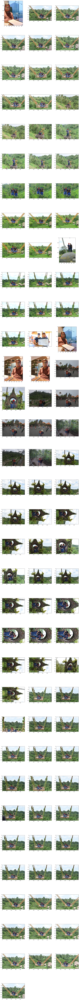

In [25]:
display_images(images, columns=3, max_images=100)

In [20]:
import gc
gc.collect()

313793